# Linear Models for Astronomers
Christina Hedges, March 2024

## About me

- British Astronomer

- Previously worked as a support scientist for Kepler/K2 at NASA ARC

- Now run the TESS Science Support Center at NASA GSFC

- Really likes linear models.

<center><img src="https://github.com/christinahedges/LinearModelTutorial/blob/gh-pages/files/meme.jpeg?raw=true"></img></center>

## What are we going to do?

Linear models are a very powerful way to model time-series in astronomy. Today we're going to break down what they are, how we can fit them, and what it enables us to do.


In astronomy data we often have multiple signals both from our astrophysical objects of interest and some systematic noise terms. We might be looking at

- 1D time series data
- 2D imaging data
- 3D data of images over time
- Higher dimensional data from catalogs


We frequently want to remove some **systematics**, to get our best understanding of the truth. "Systematics" is an astronomy catch-all term that might mean something like

- A systematic offset in image frames due to sky background
- A systematic and predictable signal in our time-series data due to thermal changes in an instrument
- A systematic increase in brightness in a spectrum at the faint end

And many others.

So how do we get the true flux of a star in an image with a systematic brightness? How do we detrend our noisy time series to remove the impact of thermal changes and preserve the true signal? How do we get accurate spectra?

And, crucially, how do we do it fast.

We're going to have to come up with some **model** for our data. This means modeling our systematics, and any astrophysical signal that's in our data, at the same time. We're going to do this with a **linear model**.

### Conventions

We're going to dive into some mathematical representations here so I'm going to write down some examples of our conventions

The font face will be used to express variables as:

- $a$ : Lowercase italics are a single numeric value
- $\mathbf a$: Lowercase bold are vectors
- $\mathbf A$: Uppercase bold are matrices

We'll try to follow this convention as much as possible in Python. Unfortunately we can't bold variables, so we'll use the slightly modified:

```python
# lowercase letter and a number, single valued variable
a0 = 1.1
# lowercase letter, vector
a = [0, 0, 0, 0.1, 0, 0]
# uppercase letter, matrix
A = [[0, 0, 1], [0, 1, 0], [1, 0, 0]]
```

# Writing down sets of linear equations

In this section, we're going to write down some linear equations using vector and matrix notation. Once we're comfortable with this we'll move onto solving equations.

# What's a Linear Model?

Here's a set of linear equations that have the same variables stored in the two element vector $\mathbf w$

$y_0 = w_0 \cdot x_0 + w_1$

$y_1 = w_0 \cdot x_1 + w_1$

$y_2 = w_0 \cdot x_2 + w_1$


This set of linear equations share the same variable $\mathbf w$. The relationship between the vector $\mathbf{y}$ and vector $\mathbf{x}$ is a linear combination of $\mathbf{x}$ dotted with some coefficients. The equation below does not have a linear between relationship between the vector $\mathbf{y}$ and vector $\mathbf{x}$

$\mathbf y = e ^{w_1 \cdot \mathbf{x}} + w_2$

This equation has two dimensions ($\mathbf{x}$ and $\mathbf{z}$) and is linear in $\mathbf{x}$, but the relationship between $\mathbf{y}$ and $\mathbf{z}$ is non-linear.

$\mathbf y = e ^{w_1 \cdot \mathbf{z}} + \mathbf{x}w_2$




## Matrix Notation

Matrix notation is going to become helpful for us. Let's express the above set of linear equations as a matrix multiplication. 

$ \mathbf y = \begin{bmatrix} x_0 & 1 \\ x_1 & 1 \\ x_2 & 1 \end{bmatrix} \cdot \mathbf w$

where

$\mathbf w = \begin{bmatrix} w_0 \\ w_1 \end{bmatrix}$


We could also write the first equation ($\mathbf y = 2 \mathbf x + 3$) as a matrix multiplication

$\mathbf y = \mathbf A \cdot \mathbf w$

Where 

$ \mathbf w = \begin{bmatrix} 2 & 3 \end{bmatrix}$ and $ \mathbf A = \begin{bmatrix} x_0 & 1 \\ x_1 & 1 \\ x_2 & 1 \\ .. & .. \\ x_n & 1 \end{bmatrix}$

$ \mathbf y = \mathbf A \cdot \mathbf w = \begin{bmatrix} x_0 & 1 \\ x_1 & 1 \\ x_2 & 1 \\ .. & ..\\ x_n & 1 \end{bmatrix} \cdot \begin{bmatrix} 2 \\ 3 \end{bmatrix}$

Putting in some values for x we find:

$ \begin{bmatrix} 3 & 5 & 7 \end{bmatrix} = \begin{bmatrix} 0 & 1 \\ 1 & 1 \\ 2 & 1 \end{bmatrix} \cdot \begin{bmatrix} 2 \\ 3 \end{bmatrix}$

## Bigger Linear Models

So long as we can write our model as something that is a set of column vector regressors with a shared set of weights, we are writing a linear model that we can solve. Your model will look like this:

$\mathbf{y} = \mathbf{A} \cdot \mathbf{w}$

$\mathbf{A} = \begin{bmatrix} x_{0,0} & x_{0,1} & x_{0,2} & .. & x_{0,n} \\
x_{1,0} & x_{1,1} & x_{1,2} & .. & x_{1,n} \\
x_{2,0} & x_{2,1} & x_{2,2} & .. & x_{2,n} \\
x_{3,0} & x_{3,1} & x_{3,2} & .. & x_{3,n} \\
x_{4,0} & x_{4,1} & x_{4,2} & .. & x_{4,n} \\
.. & .. & .. & .. & .. \\
x_{m,0} & x_{m,1} & x_{m,2} & .. & x_{m,n} \\\end{bmatrix} $ and $\mathbf{w} = \begin{bmatrix} w_{0}\\ w_{1}\\ w_{2} \\..\\ w_{n}\end{bmatrix} $

$ \begin{bmatrix} y_{0}\\ y_{1}\\ y_{2} \\..\\ y_{n}\end{bmatrix} = \begin{bmatrix} x_{0,0} & x_{0,1} & x_{0,2} & .. & x_{0,n} \\
x_{1,0} & x_{1,1} & x_{1,2} & .. & x_{1,n} \\
x_{2,0} & x_{2,1} & x_{2,2} & .. & x_{2,n} \\
x_{3,0} & x_{3,1} & x_{3,2} & .. & x_{3,n} \\
x_{4,0} & x_{4,1} & x_{4,2} & .. & x_{4,n} \\
.. & .. & .. & .. & .. \\
x_{m,0} & x_{m,1} & x_{m,2} & .. & x_{m,n} \\\end{bmatrix} \cdot \begin{bmatrix} w_{0}\\ w_{1}\\ w_{2} \\..\\ w_{n}\end{bmatrix}$

A higher order polynomial is a set of linear equations. For example, let's imagine we have a vector of times $\mathbf{t}$ for some time series, with $m$ elements. You can write a $n$th order polynomial in this "time" variable as

$ \mathbf{y} = \begin{bmatrix} t_{0}^0 & t_{0}^1 & t_{0}^2 & .. & t_{0}^n \\
t_{1}^0 & t_{1}^1 & t_{1}^2 & .. & t_{1}^n \\
t_{2}^0 & t_{2}^1 & t_{2}^2 & .. & t_{2}^n \\
t_{3}^0 & t_{3}^1 & t_{3}^2 & .. & t_{3}^n \\
t_{4}^0 & t_{4}^1 & t_{4}^2 & .. & t_{4}^n \\
.. & .. & .. & .. & .. \\
t_{m}^0 & t_{m}^1 & t_{m}^2 & .. & t_{m}^n \\\end{bmatrix} \cdot \begin{bmatrix} w_{0}\\ w_{1}\\ w_{2} \\..\\ w_{n}\end{bmatrix}$


## Fitting These Models

Now that we have a way to write down linear models, how do we solve them? 

Let's solve this [small set of linear equations](https://en.wikipedia.org/wiki/System_of_linear_equations):

\begin{cases}3x+2y-z=1\\2x-2y+4z=-2\\-x+{\frac {1}{2}}y-z=0\end{cases}

We'll write this in Python

In [1]:
import numpy as np
# Set up y vector
y = np.asarray([1, -2, 0])
# Set up design matrix
A = np.asarray([[3, 2, -1], [2, -2, 4], [-1, 0.5, -1]])

Now we'd like to solve the equation 

$\mathbf y = \mathbf A \cdot \mathbf w$

There are lots of ways to solve sets of linear equations, and I recommend you take a quick look at this point at [Python Programming and Numerical Methods - A Guide for Engineers and Scientists "Solutions to Systems of Linear Equations" section](https://pythonnumericalmethods.berkeley.edu/notebooks/chapter14.04-Solutions-to-Systems-of-Linear-Equations.html)) for some examples of how this "solving" happens.

Luckily for us, `numpy` has built in some of the solvers that are discussed above! We can use the `solve` function! `solve` will use methods such as LU decomposition to find $\mathbf{w}$ given $\mathbf{A}$ and $\mathbf{y}$

In [2]:
# Use `numpy` linalg solve to find the answer
np.linalg.solve(A, y)

array([ 1., -2., -2.])

In the above cell we've set up our system of linear equations and used `numpy`'s `linalg.solve` to find $x$, $y$, 
and $z$ respectively. 

This is great! Let's apply it to something that's a bit closer to what we need to do in astronomy.

In [3]:
n = 200 # the number of data points
m = 4 # the order of our polynomial
x = np.linspace(-1, 1, n)
A = np.vstack([x**idx for idx in range(m)]).T

# In this step, I'm going to make some fake data for us to fit
true_w = np.random.normal(size=m)
data = A.dot(true_w) + np.random.normal(0, 0.1, size=x.shape[0])

In [6]:
import matplotlib.pyplot as plt; import seaborn as sns; sns.set_context("talk");

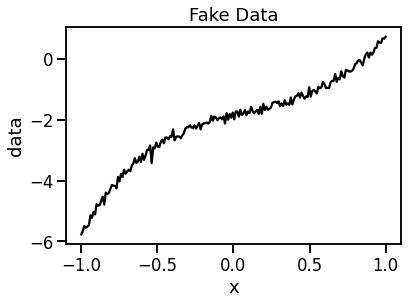

In [7]:
fig, ax = plt.subplots()
plt.plot(x, data, c='k')
ax.set(xlabel='x', ylabel='data', title='Fake Data');

I generated this data with a matrix $\mathbf A$ and randomly generated some "true" value for $\mathbf w$. Now we'd like to solve the equation 

$\mathbf y = \mathbf A \cdot \mathbf w$

Let's try `numpy`'s solve again

In [8]:
np.linalg.solve(A, data)

LinAlgError: Last 2 dimensions of the array must be square

Oh dear. No we can't.

We can't solve this system of equations as we've written it because $\mathbf A$ is not square. All the methods above $\mathbf A$ to be square. (In our description of linear models this means we need the same number of linear equations as we have coefficients to find.)

We're going to have to try to do something else.

### The Normal equation

Let's unpack what we're trying to do. We have a "hypothesis" function, some function that will give us a possible set of values to fit our data. Our hypothesis here is that the data is well fit by a polynomial with some weights. Our hypothesis is a function of guess weights

$\mathbf w = \begin{bmatrix} w_0 \\ w_1 \\ w_2 \\ .. \\ w_n \end{bmatrix}$


and input regressor vectors column vectors

$\mathbf{X} = \begin{bmatrix}\mathbf x_0 & \mathbf x_1 &\mathbf x_2 & .. & \mathbf x_n  \end{bmatrix} = \begin{bmatrix} x_{0,0} & x_{0,1} & x_{0,2} & .. & x_{0,n} \\
x_{1,0} & x_{1,1} & x_{1,2} & .. & x_{1,n} \\
x_{2,0} & x_{2,1} & x_{2,2} & .. & x_{2,n} \\
x_{3,0} & x_{3,1} & x_{3,2} & .. & x_{3,n} \\
x_{4,0} & x_{4,1} & x_{4,2} & .. & x_{4,n} \\
.. & .. & .. & .. & .. \\
x_{m,0} & x_{m,1} & x_{m,2} & .. & x_{m,n} \\\end{bmatrix} $

Written out as an equation the hypothesis function is

$h(w) = w_0 \mathbf x_0 + w_1 \mathbf x_1 + w_2 \mathbf x_2...+ w_n \mathbf x_n$


The residuals between our data $\mathbf y$ and our hypothesis function is given as $\mathbf{y}$ - $\mathbf{h}_w(\mathbf x)$.

**To find the best fitting model, we would like to minimize these residuals to fit our model.** 

As is commonly done, we're going to minimize the square of the residuals to find the best fitting model. To do this, we write some **cost function**

<center>$J(\boldsymbol w) = \frac{1}{2n}\sum_{i=1}^m (y_i$ - $h_w(x_i))^2$</center>

<small>where $m$ is the number of samples (i.e. how many data points we have) and n is the number of regressors we have.</small>

Minimizing our cost function $J$ gives us the best fitting weights to the data.

In matrix notation we can write
<center>$J(\boldsymbol w) = \frac{1}{2n}\sum_{i=1}^m (y_i$ - $h_w(x_i))^2 = \frac{1}{2n} (\mathbf X \cdot \boldsymbol w - \mathbf y)^T\cdot(\mathbf X \cdot \boldsymbol w - \mathbf y)$</center>

Let's see what this looks like in the problem we made before

In [9]:
print('n:', n)
print('m:', m)

print('first 5 rows of our design matrix:\n', A[:5])

n: 200
m: 4
first 5 rows of our design matrix:
 [[ 1.         -1.          1.         -1.        ]
 [ 1.         -0.98994975  0.98000051 -0.97015125]
 [ 1.         -0.9798995   0.96020303 -0.94090246]
 [ 1.         -0.96984925  0.94060756 -0.91224753]
 [ 1.         -0.95979899  0.92121411 -0.88418038]]


In [10]:
# Here are some random weights
guess_weights = np.random.normal(size=m)

# Below I write the cost function
# (X.dot(theta) - y).T.dot(X.dot(theta) - y)
cost = (A.dot(guess_weights) - data)[:, None].T.dot(
        (A.dot(guess_weights) - data)[:, None])

print("result of cost function:", cost)

result of cost function: [[294.08289106]]


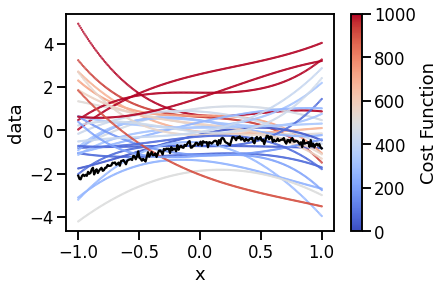

In [11]:
fig, ax = plt.subplots()
ax.plot(x, data, c='k', label='measured data')
ax.set(xlabel='x', ylabel='data')
for count in range(30):
    guess_weights = np.random.normal(size=m)
    cost = (A.dot(guess_weights) - data)[:, None].T.dot(
        (A.dot(guess_weights) - data)[:, None])
    plt.scatter(x, A.dot(guess_weights), c=np.ones(n) * cost[0],
                vmin=0, vmax=1e3, s=0.5, cmap='coolwarm')
cbar = plt.colorbar()
cbar.set_label("Cost Function");

If our guess is close, this number will be close to zero.

But we don't want a function that tells us how close to the answer we are, we want the answer. What's the best fitting weight $\boldsymbol{\theta}$? We have a cost function $J (\boldsymbol \theta)$ as a function of our weights, and we want to find where this is minimized. We want to find where:

$\frac{\partial J}{\partial \boldsymbol \theta} = 0$


In other words, we have to take the partial derivative with respect to $\boldsymbol \theta$ of our function

$J (\boldsymbol \theta) = (\mathbf X \cdot \boldsymbol w - \mathbf y)^T\cdot(\mathbf X \cdot \boldsymbol w - \mathbf y)$

<small>I dropped the fraction at the front as it'll be removed when we take the derivative</small>

<small>
$J (\boldsymbol \theta) = ((\mathbf X \cdot \boldsymbol \theta)^T - \mathbf y^T)\cdot(\mathbf X \cdot \boldsymbol \theta - \mathbf y)$

$J (\boldsymbol \theta) = ((\mathbf X \cdot \boldsymbol \theta)^T \mathbf X \cdot \boldsymbol \theta) - ((\mathbf X \cdot \boldsymbol \theta)^T \cdot \mathbf y) - (\mathbf y^T \cdot (\mathbf X \cdot \boldsymbol \theta)) + \mathbf y^T \cdot \mathbf y$

$(\mathbf X \cdot \boldsymbol \theta)$ and $\mathbf y$ are vectors (and so order of operations does not matter) so we can simplify this further into

$J (\boldsymbol \theta) = \boldsymbol \theta^T  \cdot\mathbf X^T \cdot \mathbf X \cdot \boldsymbol \theta - 2(\mathbf X \cdot \boldsymbol \theta)^T \cdot \mathbf y + \mathbf y^T \cdot \mathbf y$

Taking our partial derivative

$\frac{\partial J}{\partial \boldsymbol \theta} = 2 \cdot\mathbf X^T \cdot \mathbf X \cdot \boldsymbol \theta - 2\mathbf X^T \cdot \mathbf y$

And then to find the minimum of this function we set this to 0

$\frac{\partial J}{\partial \boldsymbol \theta} = 2 \cdot\mathbf X^T \cdot \mathbf X \cdot \boldsymbol \theta - 2\mathbf X^T \cdot \mathbf y = 0$

$2 \cdot\mathbf X^T \cdot \mathbf X \cdot \boldsymbol \theta = 2\mathbf X^T \cdot \mathbf y$

$\mathbf X^T \cdot \mathbf X \cdot \boldsymbol \theta = \mathbf X^T \cdot \mathbf y$

We can multiply both sides by $(\mathbf X^T \mathbf X)^{-1}$ in order to find $\boldsymbol \theta$ 

$\boldsymbol \theta = (\mathbf X^T \cdot \mathbf X)^{-1} \cdot  \mathbf X^T \cdot \mathbf y$</small>


$\boldsymbol \theta = (\mathbf X^T \cdot \mathbf X)^{-1} \cdot  \mathbf X^T \cdot \mathbf y$

This is the so called "normal equation". Solving this will result in the best fitting weights for our system.

Let's use it!

To find our weights $\boldsymbol w$ we can write the normal equation as

$\boldsymbol w \cdot (\mathbf A^T \cdot \mathbf A) = \cdot  \mathbf A^T \cdot \mathbf y$

Now we can use the `numpy.linalg.solve` function, because $ (\mathbf A^T \cdot \mathbf A)$ is a square matrix.`numpy.linalg.solve` will solve systems like the ones above to find $\mathbf w$. We need to pass in a matrix and a vector. We can pass this into `numpy.linalg.solve` to solve using LU decomposition:

In [12]:
best_fitting_w = np.linalg.solve(A.T.dot(A), A.T.dot(data))
best_fitting_w

array([-0.61846102,  0.8886675 , -0.8289352 , -0.17911163])

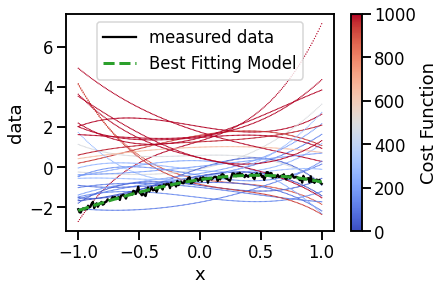

In [13]:
fig, ax = plt.subplots()
ax.plot(x, data, c='k', label='measured data')
ax.set(xlabel='x', ylabel='data')
for count in range(30):
    guess_weights = np.random.normal(size=m)
    cost = (A.dot(guess_weights) - data)[:, None].T.dot((A.dot(guess_weights) - data)[:, None])[0]
    plt.scatter(x, A.dot(guess_weights), c=np.ones(n) * cost, vmin=0, vmax=1e3, s=0.5, cmap='coolwarm', lw=0.5)
cbar = plt.colorbar()
cbar.set_label("Cost Function")
# Best fitting weights:
plt.plot(x, A.dot(best_fitting_w), color='C2', label='Best Fitting Model', lw=3, zorder=10, ls='--')
plt.legend();

We can also look at the cost function for our best fitting weights, and see it is small:

In [14]:
(A.dot(best_fitting_w) - data)[:, None].T.dot((A.dot(best_fitting_w) - data)[:, None])[0]

array([1.82557798])

And that's it! We're fitting models to data!

## Model Predictions

Now we've created a design matrix and fit to find the weights, we have a model that can provide us with **predictions** for what the data should be at any point, so long as we can create the equivalent design matrix! Let's look at the data again with the best fitting model

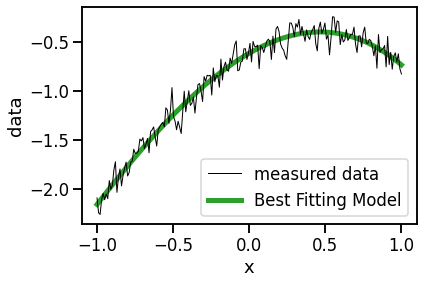

In [15]:
fig, ax = plt.subplots()
ax.plot(x, data, c='k', label='measured data', lw=1)
ax.set(xlabel='x', ylabel='data')
ax.plot(x, A.dot(best_fitting_w), color='C2', label='Best Fitting Model', lw=5, zorder=-1)
ax.legend();

Let's see what the model predicts **outside of this range!** To do this, we'll simply make a new $\mathbf{x}$ vector of new points, create a new design matrix $\mathbf{A}$ from $\mathbf{x}$, and apply the same weights.

In [16]:
# A new "x" variable, outside of our original range
x2 = np.arange(-1.2, -1, 0.01)
# Build the design matrix for this new x
A2 = np.vstack([x2**idx for idx in range(m)]).T

# Apply the same weights.
model_prediction = A2.dot(best_fitting_w)

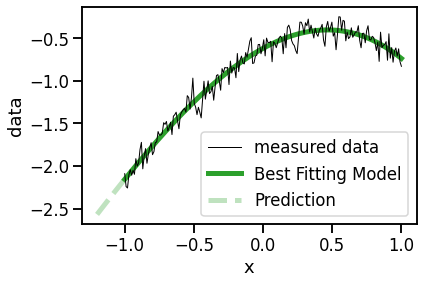

In [17]:
fig, ax = plt.subplots()
ax.plot(x, data, c='k', label='measured data', lw=1)
ax.set(xlabel='x', ylabel='data')
ax.plot(x, A.dot(best_fitting_w), color='C2', label='Best Fitting Model', lw=5, zorder=-1)
ax.plot(x2, model_prediction, color='C2', alpha=0.3, ls='--', label='Prediction', lw=5, zorder=-1)
ax.legend();

Now that we've found the weights, so long as we can build our design matrix, we can use those weights to create a model prediction at any location.

# Real Life Linear Models

We've seen how to fit linear models to data, let's look at some real data

In [19]:
data = np.loadtxt('files/kepler10.csv', delimiter=',', skiprows=1, dtype=str)
x, y, ye, row, col = [np.asarray([float(d) if d != "" else np.nan for d in dat], dtype=float) for dat in data.T]
k = np.isfinite(np.asarray([x, y, ye, row, col])).all(axis=0)
k = x < 149
x, y, ye, row, col = x[k], y[k], ye[k], row[k], col[k]
y /= y.mean()

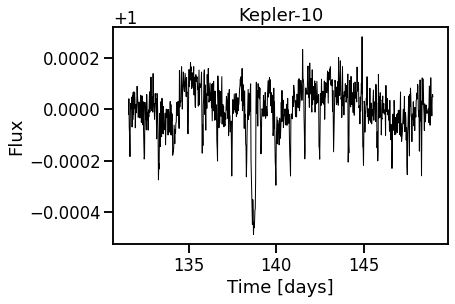

In [20]:
fig, ax = plt.subplots()
ax.plot(x, y, lw=1, label='Data', c='k')
ax.set(xlabel='Time [days]', ylabel='Flux', title='Kepler-10');

Let's build a model for this data. We'll start simple, and use a polynomial just like before

In [21]:
A = np.vstack([(x - x.mean()) ** idx for idx in range(3)]).T

In [22]:
A

array([[ 1.        , -8.72594348, 76.14208959],
       [ 1.        , -8.70550918, 75.78589015],
       [ 1.        , -8.68507499, 75.43052756],
       ...,
       [ 1.        ,  8.70439249, 75.76644854],
       [ 1.        ,  8.7248266 , 76.12259925],
       [ 1.        ,  8.74526072, 76.47958508]])

In [23]:
A.shape

(850, 3)

In [24]:
w = np.linalg.solve(A.T.dot(A), A.T.dot(y))
w

array([ 1.00000743e+00, -4.37785093e-08, -2.91156958e-07])

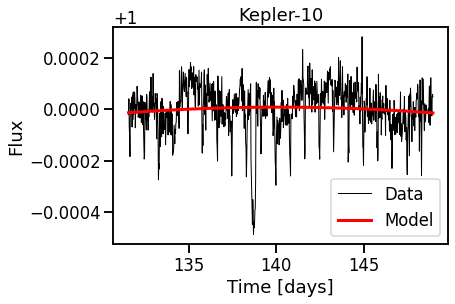

In [25]:
fig, ax = plt.subplots()
ax.plot(x, y, lw=1, label='Data', c='k')
ax.plot(x, A.dot(w), lw=3, label='Model', c='r')
ax.set(xlabel='Time [days]', ylabel='Flux', title='Kepler-10')
ax.legend();

Looks great! We've got a model that fits our data, and it looks fairly accurate! It's capturing the high level trend of the data. However, we've built a very simple model, let's improve it.

### Masking

We could mask the outliers of our data in order to fit our model. There are cases where this is fairly reasonable. 
Let's look at an example:

Perhaps I have a time series that has some chance of cosmic ray hits. I know that I might expect rare, large outliers in the data, so I am reasonably certain that I can sigma clip them out.

This is information that we have that is hard to put into our linear model. Cosmic rays could happen at any time, and have any brightness. **However,** I'm assuming here that I can easily disambiguate cosmic rays from baseline variability in the target. If this is not the case, we probably need to write a new model.


Let's look at our case above, I happen to know that there are exoplanet transits in the data, so let's start by sigma clipping.

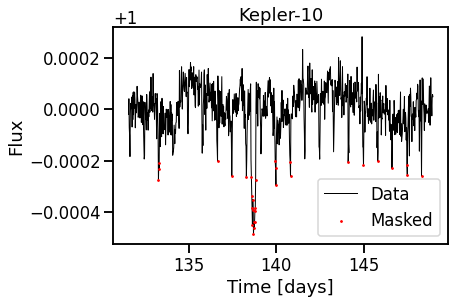

In [26]:
mask = y > 0.9998
fig, ax = plt.subplots()
ax.plot(x, y, lw=1, label='Data', c='k')
ax.scatter(x[~mask], y[~mask], lw=1, label='Masked', c='r', s=3, zorder=10)
ax.set(xlabel='Time [days]', ylabel='Flux', title='Kepler-10')
ax.legend();

In [27]:
w = np.linalg.solve(A[mask].T.dot(A[mask]), A[mask].T.dot(y[mask]))

# Remember we want the model to be evaluated everywhere,
# including the masked points, and so we don't mask the design matrix here.
model = A.dot(w)

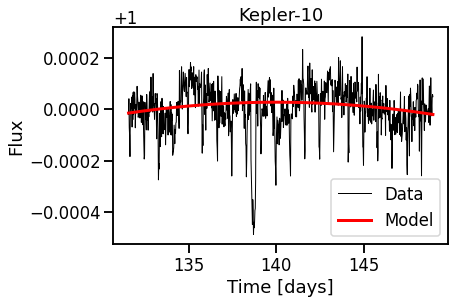

In [28]:
fig, ax = plt.subplots()
ax.plot(x, y, lw=1, label='Data', c='k')
ax.plot(x, model, lw=3, label='Model', c='r')
ax.set(xlabel='Time [days]', ylabel='Flux', title='Kepler-10')
ax.legend();

This can improve our fit, but we **do have to be careful** not to mask out too many points, as this is implicitly weighting some points more than others.

## Improving the model 

In this instance we know what's going on in our model. We know that there are two exoplanets transiting the host star. What if we build a better model to fit two things:

- The exoplanet transits
- The underlying stellar variability

In this example, I've used the [exoplanet archive](https://exoplanetarchive.ipac.caltech.edu/) to get the period and transit midpoints of the exoplanets. These can be used to create a simple model for the planets:

In [29]:
period = [0.837495 , 45.29485]
t0 = [131.543749, 138.606099]
duration = [2.1305/24, 6.9236/24]

In this very simple model, let's assume that the transits of each planet around the star can be described by a "box" function, that is zero everywhere, and has some negative value during transit. (We'll then add this to some stellar model with a mean close to one.)

Below I calculate that box for our dataset:

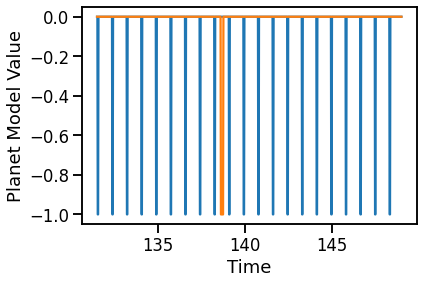

In [30]:
# Note I've used the original, un-whitened time value here
planets = -np.asarray([((x - t0[idx]) % period[idx] < duration[idx]/2) for idx in range(2)], float).T

fig, ax = plt.subplots()
ax.plot(x, planets)
ax.set(xlabel='Time', ylabel='Planet Model Value');

You can see that one planet transits very often (blue) and the second transit has only one event (orange). I can dot this matrix with some random weights to change the "depth" of the box, and sum up the contribution of both planets.

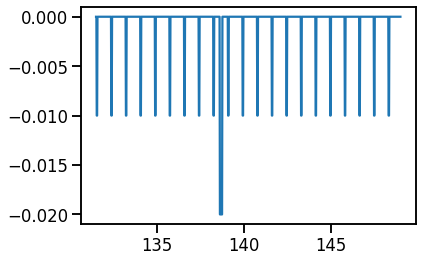

In [31]:
plt.plot(x, planets.dot([0.01, 0.02]));

Now I have a linear model for the planet transits which will allow me to fit their depths, but not period, duration or transit midpoint. 

Let's fit this simultaneously with our model for the stellar variability. To do this, all we need to do is stack the two design matrices together

In [32]:
A.shape

(850, 3)

In [33]:
planets.shape

(850, 2)

In [34]:
# Stack the two design matrices
A_simultaneous = np.hstack([A, planets])

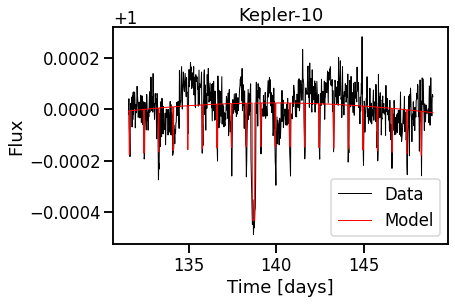

In [35]:
w = np.linalg.solve(A_simultaneous.T.dot(A_simultaneous), A_simultaneous.T.dot(y))

fig, ax = plt.subplots()
ax.plot(x, y, lw=1, label='Data', c='k')
ax.plot(x, A_simultaneous.dot(w), lw=1, label='Model', c='r')
ax.set(xlabel='Time [days]', ylabel='Flux', title='Kepler-10')
ax.legend();

You can see here that we have 

- Fit the stellar variability
- Accounted for the exoplanet transits
- Simultaneously fit to find the best fitting transit depth.

Now we've fit the model simultaneously, you can see that the transit model accounts for the outliers better than simply sigma clipping them out. We can now build the model just using the components from the stellar variability model.

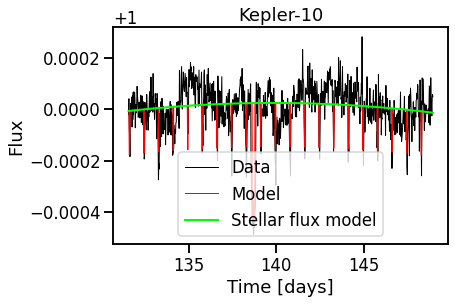

In [36]:
fig, ax = plt.subplots()
ax.plot(x, y, lw=1, label='Data', c='k')
ax.plot(x, A_simultaneous.dot(w), lw=1, label='Model', c='r')
ax.plot(x, A_simultaneous[:, :-2].dot(w[:-2]), lw=2, label='Stellar flux model', c='lime')

ax.set(xlabel='Time [days]', ylabel='Flux', title='Kepler-10')
ax.legend()

## Systematics

Let's try this with systematics from the K2 mission. Time series from the K2 mission has a "sawtooth" pattern due to the spacecraft's roll motion during data collection

In [37]:
data = np.loadtxt('files/k218.csv', delimiter=',', skiprows=1, dtype=str)
x, y, ye, row, col = [np.asarray([float(d) if d != "" else np.nan for d in dat], dtype=float) for dat in data.T]
k = np.isfinite(np.asarray([x, y, ye, row, col])).all(axis=0)
k &= x < 2015
x, y, ye, r, c = x[k], y[k], ye[k], row[k], col[k]
y /= y.mean()

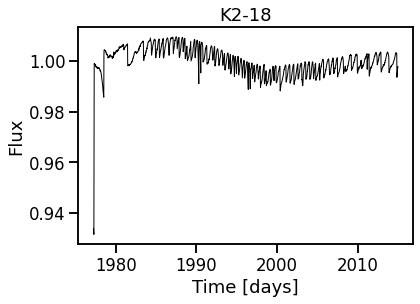

In [38]:
fig, ax = plt.subplots()
ax.plot(x, y, lw=1, label='Data', c='k')
ax.set(xlabel='Time [days]', ylabel='Flux', title='K2-18');

Here we are going to make an assumption.

**The roll motion in K2 causes a multiplicative systematic in the time-series. We're going to assume that because the change is small, we can approximate this with an additive model.**


How will we build a model for this? Before we could use a simple polynomial, but that won't capture the motion noise at all. We need a model for the motion. 

We're going to choose **regressors** which we reasonably believe predict the noise, and we'll find the best fitting weights of those regressors.

In this case, we're going to choose the column and row position of the target as a function of time as our regressors

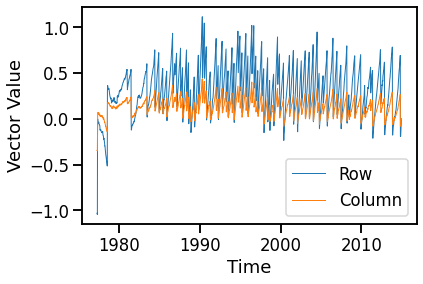

In [39]:
fig, ax = plt.subplots()
ax.plot(x, r, label='Row', lw=1)
ax.plot(x, c, label='Column', lw=1)
ax.set(xlabel='Time', ylabel='Vector Value')
ax.legend();

These look like they will well predict the motion noise in the data. Let's build a model. We're going to include

- A polynomial in time 
- A polynomial in column
- A polynomial in row

In [40]:
# Here we build a design matrix with a polynomial in time, row, and column, and row * column
A = np.vstack([*[(x - x.mean())**idx for idx in range(2)], 
               *[r**idx for idx in range(2)],
               *[c**idx for idx in range(2)]]).T

In [41]:
w = np.linalg.solve(A.T.dot(A), A.T.dot(y))

LinAlgError: Singular matrix

If you look carefully at the design matrix you can see that three of the columns are "1's". This creates a singular matrix because there is no **unique solution** to this problem.

If we include three identical column vectors, we can't solve to find the weights (they're degenerate). We just need to get rid of the identical columns in the matrix.

In [42]:
A[:3, :]

array([[  1.        , -18.88079801,   1.        ,  -1.03076661,
          1.        ,  -0.34397319],
       [  1.        , -18.86036583,   1.        ,  -1.03808701,
          1.        ,  -0.34630057],
       [  1.        , -18.83993375,   1.        ,  -1.04339004,
          1.        ,  -0.34934008]])

In [43]:
# Here we build a design matrix with a polynomial in time, row, and column, and row * column
A = np.vstack([*[(x - x.mean())**idx for idx in range(7)],
               *[r**idx for idx in range(2)][1:],
               *[c**idx for idx in range(2)][1:]]).T

w = np.linalg.solve(A.T.dot(A), A.T.dot(y))

In [44]:
A[:3, :]

array([[ 1.00000000e+00, -1.88807980e+01,  3.56484534e+02,
        -6.73071248e+03,  1.27081223e+05, -2.39939490e+06,
         4.53024904e+07, -1.03076661e+00, -3.43973190e-01],
       [ 1.00000000e+00, -1.88603658e+01,  3.55713399e+02,
        -6.70888484e+03,  1.26532022e+05, -2.38644023e+06,
         4.50091358e+07, -1.03808701e+00, -3.46300572e-01],
       [ 1.00000000e+00, -1.88399338e+01,  3.54943104e+02,
        -6.68710456e+03,  1.25984607e+05, -2.37354165e+06,
         4.47173674e+07, -1.04339004e+00, -3.49340081e-01]])

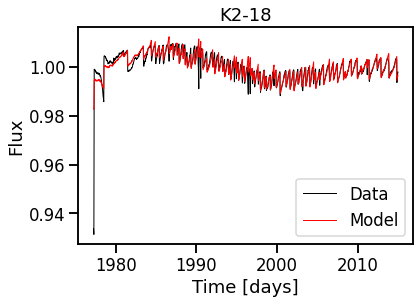

In [45]:
fig, ax = plt.subplots()
ax.plot(x, y, lw=1, label='Data', c='k')
ax.plot(x, A.dot(w), lw=1, label='Model', c='r')
ax.set(xlabel='Time [days]', ylabel='Flux', title='K2-18')
ax.legend();

Looks great! Let's look at the residuals

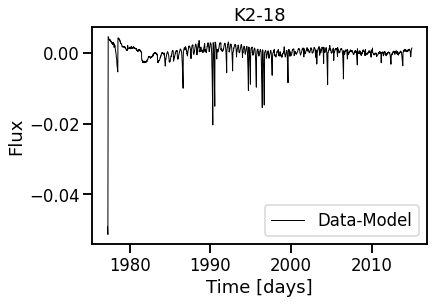

In [46]:
fig, ax = plt.subplots()
ax.plot(x, y - A.dot(w), lw=1, label='Data-Model', c='k')
ax.set(xlabel='Time [days]', ylabel='Flux', title='K2-18')

ax.legend();

We can actually improve this model by including the cross terms. That way, instead of having 3 independent, 1D polynomials, we are creating a 3D polynomial.

In [47]:
A_spatial = np.vstack([r1 * c1 for r1 in [r**idx for idx in range(2)] for c1 in [c**idx for idx in range(2)]]).T
A_time = np.vstack([(x - x.mean()) **idx for idx in range(7)]).T
A = np.vstack([t * s for t in A_time.T for s in A_spatial.T]).T

In [48]:
A.shape

(1816, 28)

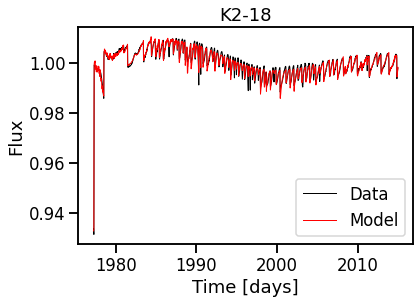

In [49]:
w = np.linalg.solve(A.T.dot(A), A.T.dot(y))
fig, ax = plt.subplots()
ax.plot(x, y, lw=1, label='Data', c='k')
ax.plot(x, A.dot(w), lw=1, label='Model', c='r')
ax.set(xlabel='Time [days]', ylabel='Flux', title='K2-18')
ax.legend();

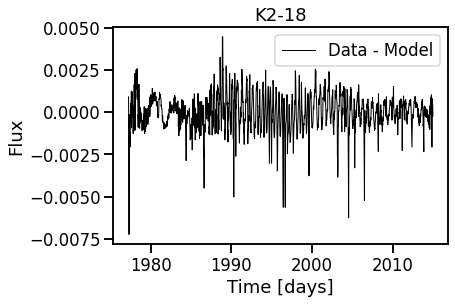

In [50]:
fig, ax = plt.subplots()
ax.plot(x, y - A.dot(w), lw=1, label='Data - Model', c='k')
ax.set(xlabel='Time [days]', ylabel='Flux', title='K2-18')

ax.legend();

Let's look at our initial assumption quickly. We chose to approximate our multiplicative correction as a linear model. 

Because we can treat this data as coming from a single source, we might write the equation for it as;
\\[\mathbf{y} = s(\mathbf{t})\cdot a(\mathbf{t})\\]

Where $s$ is some unknown function for systematics over time, and $a$ is some unknown function for astrophysics over time. If we take the logarithm of this we get;

\\[ \log_{10}(\mathbf{y}) = \log_{10}(s(\mathbf{t})) + \log_{10}(a(\mathbf{t})) \\]

This is now an additive model!

We don't know functional forms for either $s$ or $a$, and we don't know the functional forms in log space, but as before we can design flexible models to capture the variability.

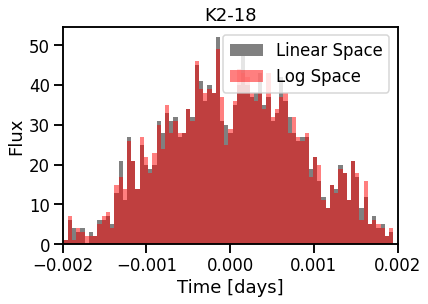

In [51]:
linear_space_w = np.linalg.solve(A.T.dot(A), A.T.dot(y))
log_space_w = np.linalg.solve(A.T.dot(A), A.T.dot(np.log10(y)))

fig, ax = plt.subplots()
ax.hist(y - A.dot(linear_space_w), np.linspace(-0.003, 0.002, 100), label='Linear Space', color='grey')
ax.hist(y - 10**A.dot(log_space_w), np.linspace(-0.003, 0.002, 100), label='Log Space', color='red', alpha=0.5)
ax.set(xlabel='Time [days]', ylabel='Flux', title='K2-18', xlim=(-0.002, 0.002))
ax.legend();

You can see in this instance this doesn't make a great deal of difference, because our initial assumption is good.

### Watch out for a gotcha...

This only works because there is **one** source in the equation. If we instead had this:

\\[\mathbf{y} = s(\mathbf{t})\cdot a_1(\mathbf{t}) + s(\mathbf{t})\cdot a_2(\mathbf{t}) + s(\mathbf{t})\cdot a_3(\mathbf{t}) ...\\]

we can no longer take the logarithm to split each part.

# Adding noise to the model

Noise is important in our applications. Sometimes I have measurements of stellar flux from different telescopes, or different times and I know they have different noise properties. Sometimes I have spectra that are noisier at particular wavelengths. It's important to be able to fold that information into our model. Let's start down this path.

Let's make our dataset again, but this time, let's add some noisier data. This might happen because of some measurement error.

In [52]:
import numpy as np
import matplotlib.pyplot as plt

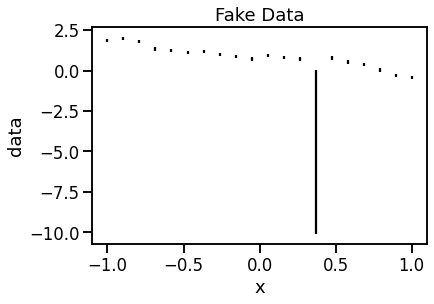

In [53]:
n = 20 # the number of data points
m = 4 # the order of our polynomial
x = np.linspace(-1, 1, n)
A = np.vstack([x**idx for idx in range(m)]).T

# In this step, I'm going to make some fake data for us to fit
true_w = np.random.normal(size=m)
data = A.dot(true_w) + np.random.normal(0, 0.1, size=x.shape[0])
error = np.ones(x.shape[0]) * 0.1

bad_idx = np.random.choice(np.arange(n), 1)
data[bad_idx] += np.random.normal(0, 5, size=1)
error[bad_idx] += 5

fig, ax = plt.subplots()
plt.errorbar(x, data, error, c='k', ls='')
ax.set(xlabel='x', ylabel='data', title='Fake Data');

**Note:** In this scenario, you **know** the noise for each data point. And you **know** the errors on those outlier datapoints. We'll touch on this again soon.

If we use OLS regression, which doesn't take into account these measurement errors, we're now going to get the wrong answer.

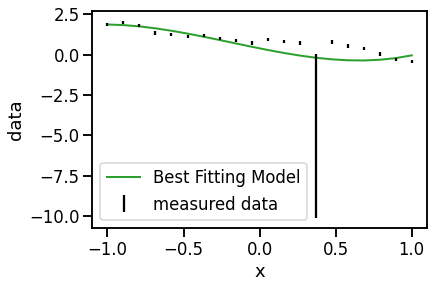

In [54]:
fig, ax = plt.subplots()
ax.errorbar(x, data, error, ls='', c='k', label='measured data')
ax.set(xlabel='x', ylabel='data')
best_fitting_w = np.linalg.solve(A.T.dot(A), A.T.dot(data))
# Best fitting weights:
plt.plot(x, A.dot(best_fitting_w), color='C2', label='Best Fitting Model', lw=2, zorder=-1)
plt.legend();

In the above example, we have a dataset with lots of well estimated datapoints (small errors) and one large outlier with a huge uncertainty. That one outlier (which we know to have a larger uncertainty) is pulling our solution to one side, because all the points have equal weights.

Instead of weighting all the points equally, we can instead have the weight of each point be given by our uncertainty in that measurement. We're going to weight each point by the inverse variance. We assume here that the "errors" reported with our data are the standard deviation, so the inverse variance for the $i$th point is $\frac{1}{\sigma_i^2}$. Weighting our cost function from the OLS derivation above, we can find a new cost function:

$J(\boldsymbol \theta) = \frac{1}{2n}\sum_{i=1}^m \frac{1}{\sigma_i^2} (y_i$ - $h_\theta(x_i))^2$


If we propagate this through our Ordinary Least Squares equation we get this;

\\[\mathbf X' = diag\left(\frac{1}{\sigma^2}\right)\mathbf X \\]
\\[\mathbf y' = diag\left(\frac{1}{\sigma^2}\right)\mathbf y \\]

Where $diag\left(\frac{1}{\sigma^2}\right)$ is a diagnoal matrix of inverse variance weights.


\\[\hat{\boldsymbol \theta}_{WLS} = (\mathbf X'^T \cdot \mathbf X')^{-1} \cdot  \mathbf X'^T \cdot \mathbf y'\\]

This is a **Weighted Least Squares**. This is the case were we only include weighting based on the errors for each data point. 

We can include this in our Python code simply using

```python
best_fitting_w = np.linalg.solve(A.T.dot(A/error[:, None]**2), A.T.dot(data/error**2))
```

which will ensure the fit is weighted by our uncertainty.

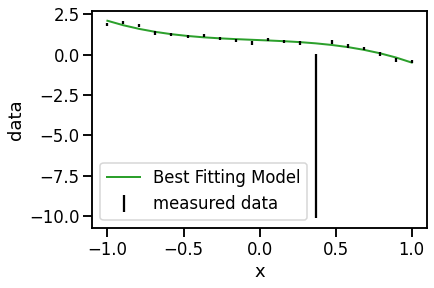

In [56]:
fig, ax = plt.subplots()
ax.errorbar(x, data, error, ls='', c='k', label='measured data')
ax.set(xlabel='x', ylabel='data')

best_fitting_w = np.linalg.solve(A.T.dot(A/error[:, None]**2), A.T.dot(data/error**2))
# Best fitting weights:
plt.plot(x, A.dot(best_fitting_w), color='C2', label='Best Fitting Model', lw=2, zorder=-1)
plt.legend();

# Adding more robust noise to the model (Generalized Least Squares)

We've already included measurement errors to our model, but this isn't the end of adding noise. Let's learn how to add a missing piece; covariance. But, to do that, we'll need to talk about what covariance is first.


## Covariance

Covariance is a measure of whether two variables "vary" together. Variables are "covariant" if they both go up or both go down at the same time. 

In [57]:
a, b = np.random.normal(size=(2, 100))

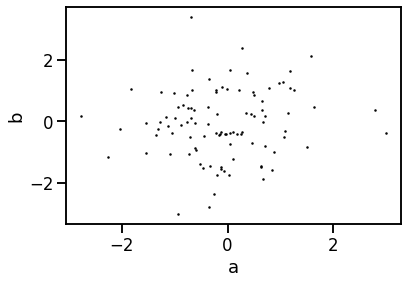

In [58]:
fig, ax = plt.subplots()
plt.scatter(a, b, c='k', s=1)
ax.set(xlabel='a', ylabel='b');

Covariance between two vectors $\mathbf x$ and $\mathbf y$ is given as

$\frac{1}{n}\sum^n_{i=0}(x_i  - \mathbf{\hat{x}})(y_i  - \mathbf{\hat{y}})$

where the hat symbol denotes the mean of the vector. If we look at the covariance for a and be we find a number very close to 0

In [59]:
np.sum((a - np.mean(a)) * (b - np.mean(b)))/len(a)

0.10779861603515185

In other words, they aren't covariant. Let's make a vector that is covariant

In [60]:
c = b + a * 1 + np.random.normal(size=(100))

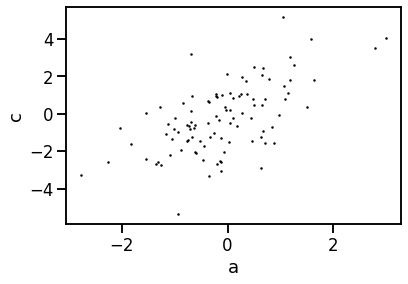

In [61]:
fig, ax = plt.subplots()
plt.scatter(a, c, c='k', s=1)
ax.set(xlabel='a', ylabel='c');

This time the covariance is a positive value much greater than 1, these are covariant vectors

In [62]:
np.sum((a - np.mean(a)) * (c - np.mean(c)))/len(a)

1.0703567076005671

Note that the "variance" of a vector is the covariance of the vector with itself!

### Covariance Matrix

In our case, we don't have just two vectors, we have a large number of vectors in our design matrix. If we want to know the covariance of each of our column vector regressors with each other, we can create a covariance matrix. 

In [63]:
X = np.vstack([a, b, c]).T

In [64]:
cov = (X - X.mean(axis=0)).T.dot((X - X.mean(axis=0)))/X.shape[0]

This will take the form

$\begin{bmatrix}
cov(a, a) &cov(a, b) &cov(a, c) \\
cov(b, a) &cov(b, b) &cov(b, c) \\
cov(c, a) &cov(c, b) &cov(c, c) \\
\end{bmatrix}$

or another way

$\begin{bmatrix}
var(a) &cov(a, b) &cov(a, c) \\
cov(b, a) &var(b) &cov(b, c) \\
cov(c, a) &cov(c, b) &var(c) \\
\end{bmatrix}$

In [65]:
cov

array([[0.90697772, 0.10779862, 1.07035671],
       [0.10779862, 1.20876729, 1.31790703],
       [1.07035671, 1.31790703, 3.36182539]])

You can see the variance of each vector in the diagonal, and the covariance of each vector pair in the off diagnoal terms.

### What do these matrices mean...?

Before we move on, let's just look at what different versions of this matrix would mean:

A covariance matrix like this
$\begin{bmatrix}
1 &0 &0 \\
0 &1 &0 \\
0 &0 &1 \\
\end{bmatrix}$

means that the input vectors **are uncorrelated**, because the off diagonal terms are 0. The **variance** of the vectors are the same, because the diagonal values are all the same.

A covariance matrix like this
$\begin{bmatrix}
3 &0 &0 \\
0 &1 &0 \\
0 &0 &2 \\
\end{bmatrix}$

means that the input vectors are uncorrelated and each vector has **different variance** because the diagonal terms are different. 

A covariance matrix like this
$\begin{bmatrix}
1 &0.2 &0.3 \\
0.2 &1 &0.4 \\
0.3 &0.4 &1 \\
\end{bmatrix}$

means that the vectors **are correlated**, and they have the same variance. 

### Covariance with weights

Frequently we have data with different weights. If we want to include errors in our covariance estimate, we can do so by weighting the covariance using those errors:

$cov(\mathbf x, \mathbf y) = \frac{1}{n}\sum^n_{i=0}\frac{(x_i  - \mathbf{\hat{x}})(y_i  - \mathbf{\hat{y}})}{\sigma_{x_i}\sigma_{y_i}}$

where $\sigma_{x_i}$ indicates the error on the $i$th element in the vector $\mathbf x$.

Let's make our data again, and this time, let's add a few outliers with larger errors

In [66]:
a, b = np.random.normal(0, 0.01, size=(2, 100))
c = b + a * 0.5 + np.random.normal(0, 0.1, size=(100))
bad_idx = np.random.choice(np.arange(100), 5)
a[bad_idx] += np.random.normal(0, 0.2, size=5)
b[bad_idx] += np.random.normal(0, 0.2, size=5)
c[bad_idx] += np.random.normal(0, 0.2, size=5)
err = np.ones(100) * 0.01
err[bad_idx] = (0.2**2 + 0.01**2)**0.5

Now I've made similar variables as before, but this time I've added five points that have more noise in them.

<ErrorbarContainer object of 3 artists>

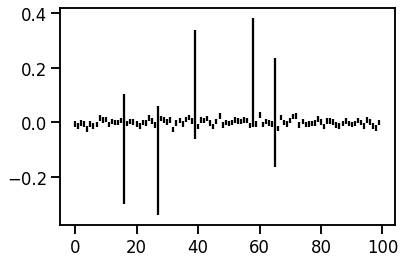

In [67]:
plt.errorbar(np.arange(100), a, err, ls='', c='k')

If we assume the vectors all have equal errors we get the following covariance matrix

In [68]:
X = np.vstack([a, b, c]).T
cov = ((X - X.mean(axis=0))/0.01**2).T.dot(((X - X.mean(axis=0))/0.01**2))/X.shape[0]

In [69]:
cov

array([[  94065.68333074,   38405.75410028,   -8472.72629127],
       [  38405.75410028,  218999.75579686,   50926.75664121],
       [  -8472.72629127,   50926.75664121, 1118708.85829104]])

This is incorrect, the values are very large, and the data has huge variance. 


If we assume the vectors have their correct errors we get

In [70]:
cov = (X - X.mean(axis=0)/err[:, None]**2).T.dot((X - X.mean(axis=0)/err[:, None]**2))/X.shape[0]

In [71]:
cov

array([[ 184.53135611,  360.84146663,  736.32188765],
       [ 360.84146663,  705.61099966, 1439.84561943],
       [ 736.32188765, 1439.84561943, 2938.11775933]])

Keep in mind, in astronomy when we get data or errors, we rarely **know** the covariance of the data or the errors. In methods such as Gaussian Process we guess some functional form of the covariance. 

This is much better behaved and reflects the covariance of the data much more accurately.

# Different kinds of Least Squares Regression

We've talked a lot about least squares, let's recap the different kinds quickly.

## Ordinary Least Squares

We've derived this above, this is


\\[\hat{\boldsymbol \theta}_{OLS} = (\mathbf X^T \cdot \mathbf X)^{-1} \cdot  \mathbf X^T \cdot \mathbf y\\]

Here we are assuming that all the data are equally weighted

In [72]:
x = np.linspace(-2, 2, 100)
true_w = np.random.normal(size=3)
X = np.vstack([x**idx for idx in range(3)]).T
y = X.dot(true_w)
ye = np.ones(len(x)) * 0.1
y += np.random.normal(0, 0.1, size=len(x))
idx = np.random.choice(np.arange(len(x)), 5)
y[idx] += np.random.normal(0, 0.7, size=5)
ye[idx] += 0.7

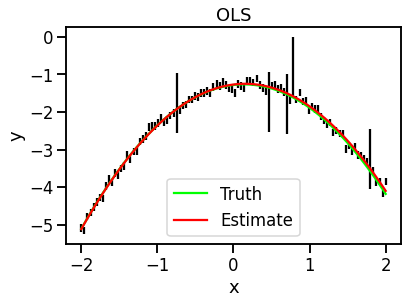

In [74]:
estimated_w = np.linalg.solve(X.T.dot(X), X.T.dot(y))


fig, ax = plt.subplots()
ax.errorbar(x, y, ye, c='k', zorder=-10, ls='')
ax.plot(x, X.dot(true_w), c='lime', label='Truth')
ax.plot(x, X.dot(estimated_w), c='r', label='Estimate')
plt.legend()
ax.set(xlabel='x', ylabel='y', title='OLS');

## Weighted Least Squares

Here we will include that the data has different weights

\\[\mathbf X' = diag(w)\mathbf X \\]
\\[\mathbf y' = diag(w)\mathbf y \\]

Where $diag(w)$ is a diagnoal matrix of weights $w$. Commonly we would choose the inverse variance as the weights. We then have the weighted least squares equation


\\[\hat{\boldsymbol \theta}_{WLS} = (\mathbf X'^T \cdot \mathbf X')^{-1} \cdot  \mathbf X'^T \cdot \mathbf y'\\]



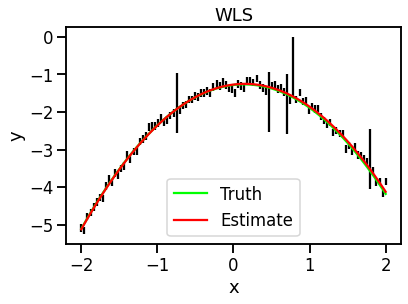

In [75]:
estimated_w = np.linalg.solve(X.T.dot(X/ye[:, None]**2), X.T.dot(y/ye**2))


fig, ax = plt.subplots()
ax.errorbar(x, y, ye, c='k', zorder=-10, ls='')
ax.plot(x, X.dot(true_w), c='lime', label='Truth')
ax.plot(x, X.dot(estimated_w), c='r', label='Estimate')
plt.legend()
ax.set(xlabel='x', ylabel='y', title='WLS');

## Generalized Least Squares

In generalized least squares we assume we know the full covariance matrix of the errors on the data $\Sigma$.


\\[\hat{\boldsymbol \theta}_{GLS} = (\mathbf X^T \cdot \boldsymbol \Sigma^{-1} \cdot \mathbf X)^{-1} \cdot  \mathbf X^T \cdot \boldsymbol \Sigma^{-1} \cdot \mathbf y\\]


(Note that in practice in astronomy we do not usually have access to this information.)

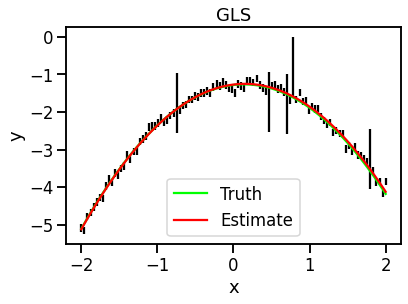

In [76]:
error_inv_cov = np.diag(1/ye**2)
estimated_w = np.linalg.solve(X.T.dot(error_inv_cov).dot(X), X.T.dot(error_inv_cov).dot(y))


fig, ax = plt.subplots()
ax.errorbar(x, y, ye, c='k', zorder=-10, ls='')
ax.plot(x, X.dot(true_w), c='lime', label='Truth')
ax.plot(x, X.dot(estimated_w), c='r', label='Estimate')
plt.legend()
ax.set(xlabel='x', ylabel='y', title='GLS');

## Bayesian Linear Regression

<center>"But we don't know anything about the mass of these planets!"</center>

<center> "That's not true. We know they <i>have</i> mass." </center>

Prior information is very powerful. It enables us to create models informed by our real understanding of the universe. 

In this world of linear regression, priors are simple functions that give us some information about the "bounds" of the truth. 

When we apply priors to our GLS equation, we are treating this as [Bayesian Linear Regression](https://en.wikipedia.org/wiki/Bayesian_linear_regression). This includes prior information on the weights, where the prior is a simple Gaussian (with a mean and standard deviation.)

The derivative in the link shows that GLS becomes the following, where $\boldsymbol \Lambda_0$ is the matrix that describes the prior covariance and $\boldsymbol \theta_0$ is the vector that describes the prior mean. (Note the subscript "$0$" here is implying that this is our prior estimate.)



\\[\hat{\boldsymbol \theta}_{bayes} = (\mathbf X^T \cdot \mathbf X + \boldsymbol \Lambda_0)^{-1} \cdot  (\mathbf X^T  \cdot \mathbf y + \boldsymbol\Lambda_0 \boldsymbol\theta_0)\\]

The Bayesian Linear Regression equation is powerful for us, because it enables us to specify our prior belief on the weights of any of the vectors. This is excellent for two reasons;

- We might have genuine prior information on, for example, the average flux of a star, and it is beneficial to fold that into our model.
- We might have a model where there are two similar components of the same variable, for example stars might vary as a function of time, but our systematics might also vary as a function of time. Priors enable us to still include both these parts of our model but weight them, so they are not degenerate. 

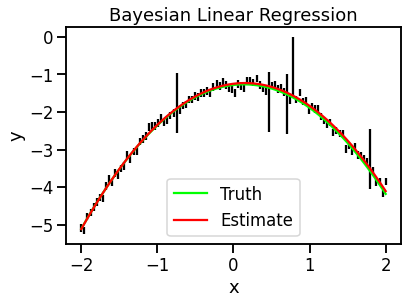

In [77]:
prior_sigma = np.ones(X.shape[1])
prior_mu = np.zeros(X.shape[1])
estimated_w = np.linalg.solve(X.T.dot(X) + np.diag(1/prior_sigma**2), X.T.dot(y) + prior_mu/prior_sigma**2)


fig, ax = plt.subplots()
ax.errorbar(x, y, ye, c='k', zorder=-10, ls='')
ax.plot(x, X.dot(true_w), c='lime', label='Truth')
ax.plot(x, X.dot(estimated_w), c='r', label='Estimate')
plt.legend()
ax.set(xlabel='x', ylabel='y', title='Bayesian Linear Regression');

This becomes a powerful way to break degeneracies in our model. If we have two vectors in our design matrix that "look similar", we can add prior information to break the degeneracies!

## Why do we like these methods?


Remember that our whole reason for choosing these methods is we can find the **maximum liklihood solution** for the best fitting weights using simple algebra, and **we do not have to sample**.

Some models will require that we have to explore parameter space to find hyper parameters, or fit variables using sampling techniques like MCMC. If we are able to build a linear model we can find the best fitting weights very quickly. 

Using Bayesian linear regression is an intuitive way of building a model. We bake our assumptions into the model in a few places;

1. The choice of design matrix. If we know our model varies as a function of time, position, flux etc, we choose vectors for our design matrix that include those attributes.

2. The choice of priors. If we use priors, we can constrain our fit to physically reasonable parameters.

This ultimately makes models that are intuitive and interpretable. There are, of course, trade offs. Your model is effectively only as good as the design matrix you are able to construct. While we can make flexible models that provide estimates of the uncertainties, they're really only as good as the design matrix we make.

If you imagine a case where you are able to create an "infinite" design matrix, you would not have to bake in this knowledge, or choose vectors. 

In this case, you have a "non-parametric" model, where you don't feed in any specific parameters that you expect the data to vary with. 

This is a Gaussian Process. In a Gaussian Process, you never make a design matrix. Instead, you specify a function to build the covariance matrix of the data which has "properties" you want. That might be "smoothness" or "periodicity". You then fit to find the "hyperparameters" of this kernel function.

Linear Regression is very **interpretable** but is parameteric
Gaussian Processes are less interpreatable, but are **non-parametric**.

Linear Regression can be very fast, because we're using a finite number of regressors.

# What about model uncertainties?

Often it will be important for us to understand the uncertainties in our model fit. This might be for two reasons;

1. We want to understand the uncertainties on the best fit weights
2. We want to obtain a range of possible models, not simply the maximum likelihood model.

We can absolutely do this, let's look into it quickly.

First I'll create some random noisy data with a 3rd order polynomial.

In [78]:
true_w = np.asarray([0.545, 1.560, 0.14598, 0.1])
x = np.arange(-10, 10, 0.1) 
y = np.asarray([x**idx for idx in range(4)]).T.dot(true_w)
y += np.random.normal(0, 30, size=x.shape)
ye = np.ones(x.shape) * 30

If we look at this data, it has a fair amount of noise.

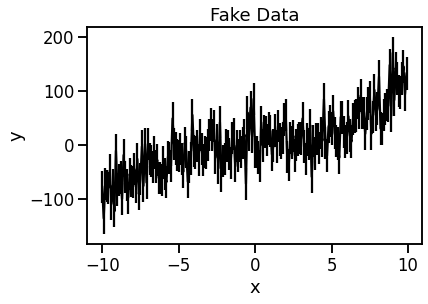

In [79]:
fig, ax = plt.subplots()
ax.errorbar(x, y, ye, color='k')
ax.set(xlabel='x', ylabel='y', title='Fake Data');

Let's fit the data. We'll use Weighted Least Squares (WLS) so that our measurement errors are propagated into the model.

In [80]:
A = np.asarray([x**idx for idx in range(4)]).T
sigma_w_inv = A.T.dot(A/ye[:, None]**2)
B = A.T.dot(y/ye**2)
w = np.linalg.solve(sigma_w_inv, B)

The first part of our least squares equation is the inverse of the standard deviation of the best fit weights. If we want the weights on the individual errors we can take the diagonal of this matrix.

In [81]:
w_err = np.linalg.inv(sigma_w_inv).diagonal()

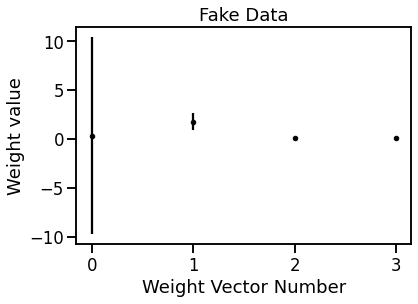

In [82]:
fig, ax = plt.subplots()
plt.errorbar(np.arange(len(w)), w, w_err, ls='', marker='.', color='k')
ax.set(xlabel='Weight Vector Number', ylabel='Weight value', title='Fake Data');

Alternatively, we can draw from this distribution to sample the best fitting weights given our uncertainties in them.

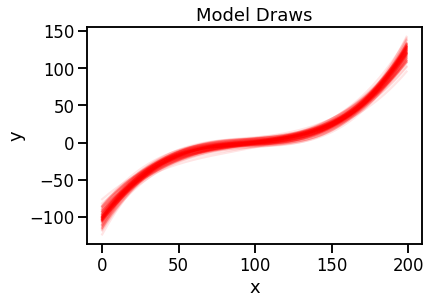

In [84]:
# 100 samples of the weights
fig, ax = plt.subplots()
weight_samples = np.random.multivariate_normal(w, np.linalg.inv(sigma_w_inv), size=100)
ax.plot(A.dot(weight_samples.T), alpha=0.1, color='r');
ax.set(xlabel='x', ylabel='y', title='Model Draws');

Remember that the weights you get back are **distributions** with a mean, and a standard deviation. To encorporate your model uncertainties in your analysis, sample from these distributions. The weights have mean $\hat{\boldsymbol \theta}$ and covariance $\Lambda$ where 

\\[\Lambda = (\mathbf X^T \cdot \boldsymbol \Sigma^{-1} \cdot \mathbf X)^{-1}\\]

\\[\hat{\boldsymbol \theta} = (\mathbf X^T \cdot \boldsymbol \Sigma^{-1} \cdot \mathbf X)^{-1} \cdot  \mathbf X^T \cdot \boldsymbol \Sigma^{-1} \cdot \mathbf y\\]

# Bigger models with more dimensions

In the above example we had a multi-dimensional model. We had a model that was a function of **time**, **row**, and **column**. This becomes very handy when we want to model e.g. image data. 

In [86]:
import pickle
from utils import animate
r = pickle.load(open('files/tpf.p', 'rb'))
x, y, ye, row, column = r['time'][:300], r['flux'][:300], r['flux_err'][:300], r['row'][:300], r['column'][:300]

## TESS Image Time Series

The NASA TESS mission takes image data at a rapid cadence in 27 day sectors, observing approximately half the sky over the course of the year. This data can be used to better understand the variability of stars, or identify transiting exoplanets. However, TESS has a significant systematic where scattered light from the earth and moon is picked up by the cameras.

This animation shows a small cut out of TESS data, where the scattered light is significant at the beginning of the observation. 

In [87]:
animate(y - np.median(y), xlabel='Column Pixel', ylabel='Row Pixel', vmin=-20, vmax=20)

We can build a simple linear model to remove this additive noise source. Let's look at the shape of the data.

In [88]:
y.shape

(300, 15, 16)

There are 300 time cadences, 15 rows, and 16 columns in the dataset. 

In our framework we're only able to fit 1D time-series, and so we will have to reshape this image. Instead of fitting the image as is, let's instead fit each pixel time series.

In [89]:
y[:, np.ones(y.shape[1:], bool)].shape

(300, 240)

This array has the right shape for us to fit individual pixel time series.

We know this scattered background noise is spatial dependent, when we look at the data we can see this is a fairly smooth function in column and row that changes over time. We'll use the row and column positions of each pixel as the vectors for our design matrix. 

In [90]:
print(row.ravel()[:20], '...')
print(column.ravel()[:20], '...')

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1] ...
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15  0  1  2  3] ...


In [91]:
A = np.vstack([np.ones(np.prod(row.shape)),
              row.ravel(),
              column.ravel(),
              (row * column).ravel()]).T

This design matrix is a simple 1st order, 2D polynomial in row and column. 

You can see that the design matrix has an entry for every pixel.

In [92]:
A.shape

(240, 4)

Let's fit our model! We'll fit to just the first frame of the data for now.

In [93]:
w = np.linalg.solve(A.T.dot(A), A.T.dot(y[0].ravel()))

In [94]:
w

array([190.13824571,   2.27547152,  -1.49809137,   0.40654601])

Now we can generate our model. Note that the model needs to be reshaped so that it has the correct image dimensions. 

In [95]:
model = A.dot(w).reshape(y.shape[1:])

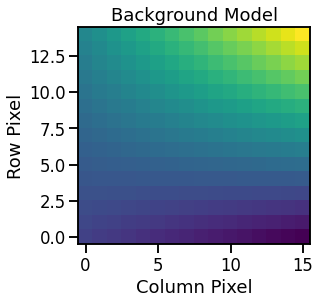

In [96]:
fig, ax = plt.subplots()
plt.imshow(model, origin='lower')
ax.set(xlabel='Column Pixel', ylabel='Row Pixel', title='Background Model');

That's a smooth model! Let's look at the residuals.

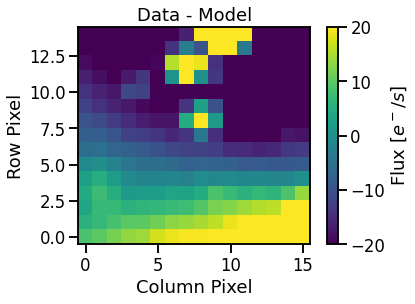

In [97]:
fig, ax = plt.subplots()
im = plt.imshow(y[0] - model, origin='lower', vmin=-20, vmax=20)
cbar = plt.colorbar(im, ax=ax)
cbar.set_label("Flux [$e^-/s$]")
ax.set(xlabel='Column Pixel', ylabel='Row Pixel', title='Data - Model');

Hm. The background pixels -should- be close to zero, but they are actually large, negative values. What's going on?

Well, we fit our model to -all- the pixels in the image. And those pixels with bright stars in the image are actually skewing the fit. The model has no way to fit the bright targets, it can only fit the average. This is not what we want.

There are a few ways we can move forward.

## Idea 1: We can mask out bright pixels.

We've got quite a lot of data, and there aren't many stars in the image. We could try masking out the stars in the image and then fit our model. This will ensure we're not being skewed by the bright pixels. Let's try it.


In [98]:
# I've set this by hand looking at the data, as a reasonable pixel mask
# If you're doing this to your own data, think carefully about how to mask it

# Mask is True anywhere where the flux is less than 150
mask = y[0].ravel() < 210

In [99]:
w = np.linalg.solve(A[mask].T.dot(A[mask]),
                    A[mask].T.dot(y[0].ravel()[mask]))

Ok we've found our best fitting weights! Now let's make our model. Remember we're not going to mask the design matrix this time, because we want to know the value of the model at all pixels.

In [100]:
model = A.dot(w).reshape(y.shape[1:])

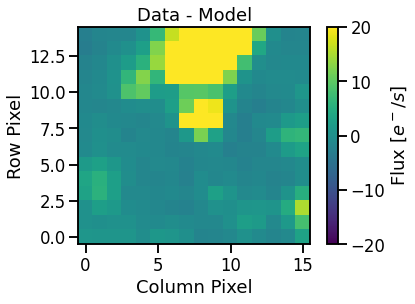

In [101]:
fig, ax = plt.subplots()
im = plt.imshow(y[0] - model, origin='lower', vmin=-20, vmax=20)
cbar = plt.colorbar(im, ax=ax)
cbar.set_label("Flux [$e^-/s$]")
ax.set(xlabel='Column Pixel', ylabel='Row Pixel', title='Data - Model');

Great! Now the model is fitting only the background pixels, and the value of the background pixels is close to zero!

## Idea 2: We could change our model

What if we don't have enough data that we can afford to mask some of it out? Then we're going to need a better model for the data. Let's update our model so that it can flexibly fit around the stars. 

For this TESS data, we have 300 frames of the same patch of sky, which should have approximately the same star scene, but variable amounts of background.

Let's try a model that is our simple polynomial + the average image over time.

In [102]:
avg = y.mean(axis=0)

In [103]:
avg.shape

(15, 16)

Because the average image still has background in it, I'm going to median subtract the average. 

In [104]:
avg = y.mean(axis=0)
avg -= np.median(avg)

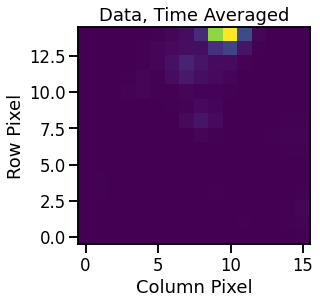

In [106]:
fig, ax = plt.subplots()
plt.imshow(avg, origin='lower')
ax.set(xlabel='Column Pixel', ylabel='Row Pixel', title='Data, Time Averaged');

We'll need a new design matrix

In [107]:
A = np.vstack([np.ones(np.prod(row.shape)),
            row.ravel(),
            column.ravel(),
            (row * column).ravel(),
            avg.ravel()]).T

In [108]:
A.shape

(240, 5)

Now we have an additional vector which is the average image over time. Let's fit the model again, this time we don't need to mask pixels.

In [109]:
w = np.linalg.solve(A.T.dot(A), A.T.dot(y[0].ravel()))

In [110]:
model = A.dot(w).reshape(y.shape[1:])

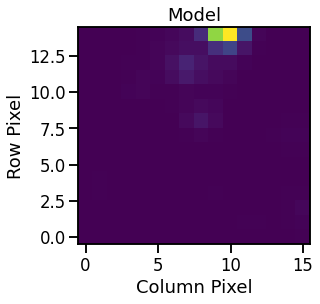

In [111]:
fig, ax = plt.subplots()
plt.imshow(model, origin='lower')
ax.set(xlabel='Column Pixel', ylabel='Row Pixel', title='Model');

Now our model includes the stars, because we've included the average as one of our matrix components. We wanted to do this to allow the model to flexibly fit the background around the stars, but in our case we only want to use the model for the background.

To achieve this, let's use the weights that are for the polynomial coefficients only. Below I make the model using all but the last components of the design matrix, because the last component is the "average" (see above).

In [112]:
model = A[:, :-1].dot(w[:-1]).reshape(y.shape[1:])

In [113]:
model.shape

(15, 16)

The model still has the same number of pixels.

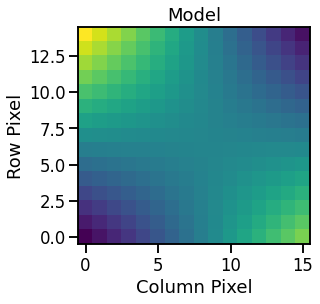

In [114]:
fig, ax = plt.subplots()
plt.imshow(model, origin='lower')
ax.set(xlabel='Column Pixel', ylabel='Row Pixel', title='Model');

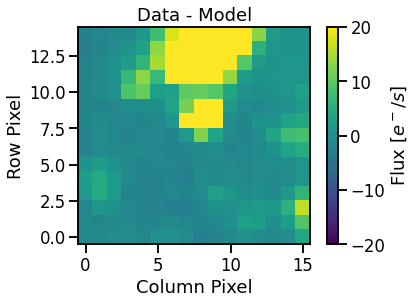

In [115]:
fig, ax = plt.subplots()
im = plt.imshow(y[0] - model, origin='lower', vmin=-20, vmax=20)
cbar = plt.colorbar(im, ax=ax)
cbar.set_label("Flux [$e^-/s$]")
ax.set(xlabel='Column Pixel', ylabel='Row Pixel', title='Data - Model');

Now we've fit the data and removed the background, without the stars skewing the fit. Great!

## Fitting the same model many times

Now that you've seen we can fit a 2D model to a frame, what if we want to fit the same model to many frames?

We can do that easily, first let's do it by iterating.

In [116]:
%%time
ws = np.asarray([np.linalg.solve(A.T.dot(A), A.T.dot(frame.ravel())) for frame in y])

CPU times: user 10.2 ms, sys: 2.55 ms, total: 12.7 ms
Wall time: 11.4 ms


In [117]:
ws.shape

(300, 5)

I've created weights for every frame in the data. You can see it has shape 300 (number of frames) by 5 (number of components in the model). I've done this by iterating over every frame.

Let's make the model for all of these frames. (Remember, we're only using the first 4 components, because we don't want to include the average.)


In [118]:
model = np.asarray([A[:, :-1].dot(w[:-1]).reshape(y.shape[1:]) for w in ws])

We've made a model with the same shape as the data. Let's look at the residuals.

In [119]:
animate(y - np.median(y), xlabel='Column Pixel', ylabel='Row Pixel', title='TPF Data',
        vmin=-20, vmax=20)

And below is the model itself

In [120]:
animate(model - np.median(model), xlabel='Column Pixel', ylabel='Row Pixel', title='TPF Model', 
       vmin=-20, vmax=20)

Let's look at the residuals between the data and the model.

In [121]:
animate(y - model, xlabel='Column Pixel', ylabel='Row Pixel', title='Data - Model',
        vmin=-20, vmax=20)

You can see that we've now removed the changing background! This is excellent, and exactly what we were trying to achieve.

This model is a starting point. We could perhaps improve the model by, for example, folding in the knowledge that frames that are close together in time might have similar parameters. We'll leave that to another exercise for now.

# Fitting a periodogram

In astronomy we often want to fit periodograms. We might do this in a few different ways, but one way it is possible is to build a linear model. 

In astronomy we might have data that looks something like this.

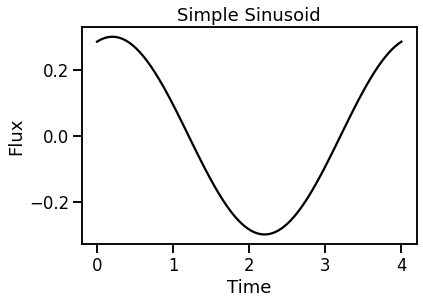

In [122]:
x = np.linspace(0, 4, 100)
period = 4
amplitude = 0.3
phase = 1.254
y = amplitude * np.sin(x * (2 * np.pi)/period + phase)
fig, ax = plt.subplots()
ax.plot(x, y, c='k')
ax.set(xlabel='Time', ylabel='Flux', title='Simple Sinusoid');

That figure is $sin(\frac{2x\pi}{P})$ where $P$ is the period of the curve. If we want to make a model where **$P$ is a variable** in our model, this **cannot be a linear model** because it is inside the $sin$ function. There is no way for us to tune the period $P$ in this model by multiplying by a coefficient.

Multiplying by a coefficient will only change the amplitude of the curve:

\\[w_0 sin(\frac{2x\pi}{P})\\]

So what do we do? In a case where we happen to know a period, we can use a linear model to find the best fitting amplitude of the sinusoid, but we can't use a linear model to find the best fitting period. Let's break this up, to fit a sinusoid model we're going to need to be able to fit

- The amplitude
- The period
- The phase

For **amplitude**, we can already do that, if we set up a linear model the coefficients will tune the amplitude. For the **phase**, we can rely on [trigonometric identities](https://en.wikipedia.org/wiki/List_of_trigonometric_identities#Shifts_and_periodicity) that tell us that a linear combination of sine and cosine curves with different weights produce a new sinusoid with a different phase:

$a\cos x+b\sin x=c\cos(x+\varphi)$

So, for any given period, we can make a linear model of a sine and cosine, and that will allow us to fit any amplitude and any phase. Let's try it!

In [123]:
# Design matrix that includes a sine and cosine with fixed period
A = np.vstack([np.sin(2 * np.pi * x/period),
               np.cos(2 * np.pi * x/period)]).T

In [124]:
# Fit to find best fitting weights
w = np.linalg.solve(A.T.dot(A), A.T.dot(y))

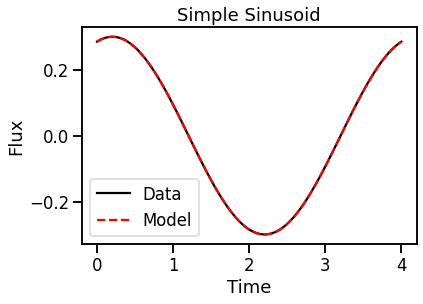

In [125]:
fig, ax = plt.subplots()
ax.plot(x, y, c='k', label='Data')
ax.plot(x, A.dot(w), c='r', ls='--', label='Model')
ax.set(xlabel='Time', ylabel='Flux', title='Simple Sinusoid')
ax.legend();

## Iterating over non-linear variables.

Often, we will need to find the period of some time series variability. Unfortunately, since including period makes this model non-linear, we'll have to iterate to find that variable. Here is an example where the data has a random period between 1 and 2 days, a random amplitude, and random phase.

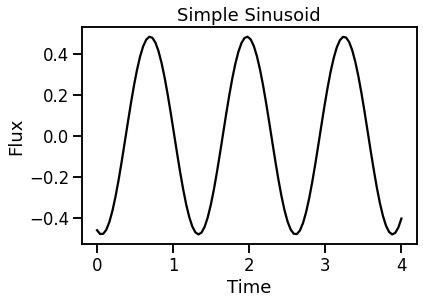

In [126]:
x = np.linspace(0, 4, 100)
period = np.random.uniform(low=1, high=2)
amplitude = np.random.normal()
phase = np.random.uniform(low=0, high=2*np.pi)
y = amplitude * np.sin(x * (2 * np.pi)/period + phase)
fig, ax = plt.subplots()
ax.plot(x, y, c='k')
ax.set(xlabel='Time', ylabel='Flux', title='Simple Sinusoid');

Let's iterate over some trial periods to find the best fitting period

In [127]:
trial_periods = 1/np.linspace(1/10, 1/0.1, 1000)[::-1]
best_fitting_weights = np.zeros((2, trial_periods.shape[0]))
for idx, trial_period in enumerate(trial_periods):
    # Design matrix that includes a sine and cosine with fixed period
    A = np.vstack([np.sin(2 * np.pi * x/trial_period), np.cos(2 * np.pi * x/trial_period)]).T
    # Fit to find best fitting weights
    best_fitting_weights[:, idx] = np.linalg.solve(A.T.dot(A), A.T.dot(y))

In [128]:
best_fitting_weights.shape

(2, 1000)

Now we have an array of best fitting weights. The shape is 2 by 1000, because we have 2 vectors in our design matrix (sine and cosine) and we have 1000 test periods. 

We'll define the "power" of the fit for any given period as the sum of the squares of the weight coefficients, i.e. $w_{0, p}^2 + w_{1, p}^2$ for any given period $p$.

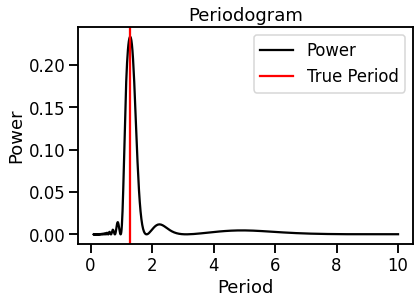

In [129]:
fig, ax = plt.subplots()
power = np.sum(best_fitting_weights**2, axis=0)
ax.plot(trial_periods, power, c='k', label='Power')
ax.axvline(period, color='r', label='True Period')
ax.legend()
ax.set(xlabel='Period', ylabel='Power', title='Periodogram');

Now we've created a simple, classical periodogram! We can see there's a clear increase in power at the correct  period. We can rebuild the model and see how well it fits the data.

In [130]:
best_fit_period = trial_periods[np.argmax(power)]
# Design matrix that includes a sine and cosine with fixed period
A = np.vstack([np.sin(2 * np.pi * x/best_fit_period), np.cos(2 * np.pi * x/best_fit_period)]).T
# Fit to find best fitting weights
w = np.linalg.solve(A.T.dot(A), A.T.dot(y))

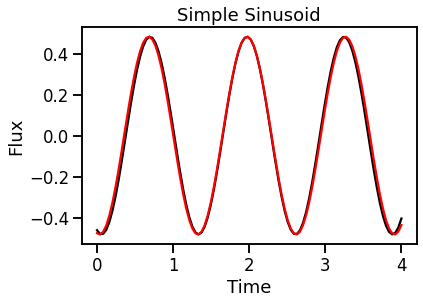

In [131]:
fig, ax = plt.subplots()
ax.plot(x, y, c='k')
ax.plot(x, A.dot(w), c='r')
ax.set(xlabel='Time', ylabel='Flux', title='Simple Sinusoid');

Looks pretty good! If we wanted to be more accurate, we would increase the number of trial periods. 

Let's try this on our Kepler dataset.

In [132]:
data = np.loadtxt('files/kepler10.csv', delimiter=',', skiprows=1, dtype=str)
x, y, ye, row, col = [np.asarray([float(d) if d != "" else np.nan for d in dat], dtype=float) for dat in data.T]
k = np.isfinite(np.asarray([x, y, ye, row, col])).all(axis=0)
x, y, ye, row, col = x[k], y[k], ye[k], row[k], col[k]
y /= y.mean()

[Text(0.5, 0, 'Time [days]'),
 Text(0, 0.5, 'Flux'),
 Text(0.5, 1.0, 'Kepler-10')]

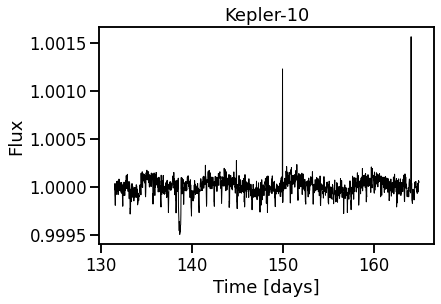

In [133]:
fig, ax = plt.subplots()
ax.plot(x, y, lw=1, label='Data', c='k')
ax.set(xlabel='Time [days]', ylabel='Flux', title='Kepler-10')

Let's try to find the best fitting period for this time series.

In [134]:
trial_periods = 1/np.linspace(1/10, 1/5, 1000)[::-1]
best_fitting_weights = np.zeros((2, trial_periods.shape[0]))
for idx, trial_period in enumerate(trial_periods):
    # Design matrix that includes a sine and cosine with fixed period
    A = np.vstack([np.sin(2 * np.pi * x/trial_period), np.cos(2 * np.pi * x/trial_period)]).T
    # Fit to find best fitting weights
    best_fitting_weights[:, idx] = np.linalg.solve(A.T.dot(A), A.T.dot(y))

[Text(0.5, 0, 'Period'), Text(0, 0.5, 'Power'), Text(0.5, 1.0, 'Periodogram')]

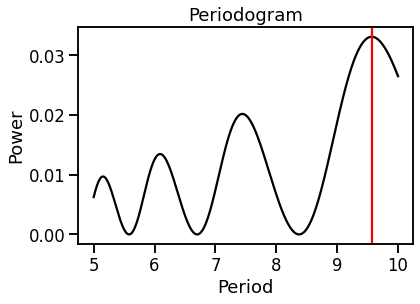

In [135]:
fig, ax = plt.subplots()
power = np.sum(best_fitting_weights[:2]**2, axis=0)
ax.plot(trial_periods, power, c='k')
ax.axvline(trial_periods[np.argmax(power)], color='r')
ax.set(xlabel='Period', ylabel='Power', title='Periodogram')

Now we can make the model at that period

In [136]:
period = trial_periods[np.argmax(power)]
A = np.vstack([np.sin(2 * np.pi * x/period), np.cos(2 * np.pi * x/period), np.ones_like(x)]).T
w = np.linalg.solve(A.T.dot(A), A.T.dot(y))

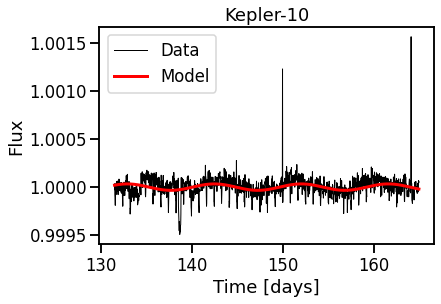

In [137]:
fig, ax = plt.subplots()
ax.plot(x, y, lw=1, label='Data', c='k')
ax.plot(x, A.dot(w), lw=3, label='Model', c='r')
ax.set(xlabel='Time [days]', ylabel='Flux', title='Kepler-10')
ax.legend();

Now we've iterated over period, we've found the best fit sinusoid model! We can use the periodogram above to tell us the best fit period in the data. 

In [138]:
period

9.568965517241379

## Why is this important?

You might ask why is this important. There are lots of tools to compute a periodogram which don't require you to write the design matrix, and in fact there are *better* ways of doing a periodogram. So why is this useful? Well two reasons;

1. This gives us some intuition for what a periodogram is doing
2. We can now augment this model, to allow us to fit other behavior simultaneously!

Let's imagine we have this scenario instead:

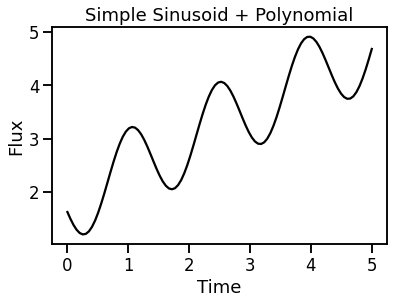

In [139]:
x = np.linspace(0, 5, 100)
period = np.random.uniform(low=1, high=2)
amplitude = np.random.normal()
phase = np.random.uniform(low=0, high=2*np.pi)
w = np.random.normal(size=2)
y = amplitude * np.sin(x * (2 * np.pi)/period + phase) + w[0]*x**0 + w[1]*x**1
fig, ax = plt.subplots()
ax.plot(x, y, c='k')
ax.set(xlabel='Time', ylabel='Flux', title='Simple Sinusoid + Polynomial');

Now, we have two parts of the model; there is an additive polynomial trend on top of our sinusoid. We can easily build a linear model to fit both of these at the same time!

Below I obtain the periodogram in the same way as above, but this time, I include polynomial terms. The design matrix is made up of the column vectors: 
- $sin(\mathbf{x})$, $cos(\mathbf{x})$ for a `polyorder` of 0, 
- $sin(\mathbf{x})$, $cos(\mathbf{x})$, $\mathbf{x}^0$ for a `polyorder` of 1, 
- $sin(\mathbf{x})$, $cos(\mathbf{x})$, $\mathbf{x}^0$, $\mathbf{x}^1$ for a `polyorder` of 2 

The true simulated data above has a polynomial order of 2.

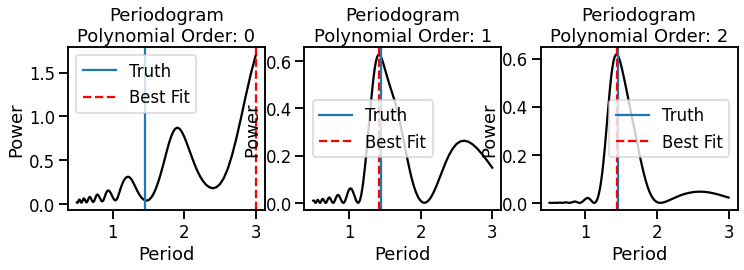

In [140]:
trial_periods = 1/np.linspace(1/3, 1/0.5, 200)[::-1]
fig, axs = plt.subplots(1, 3, figsize=(12, 3), sharex=True)
for polyorder in np.arange(3):
    ax = axs[polyorder]
    best_fitting_weights = np.zeros((2+polyorder, trial_periods.shape[0]))
    for idx, trial_period in enumerate(trial_periods):
        # Design matrix that includes a sine and cosine with fixed period
        A = np.vstack([np.sin(2 * np.pi * x/trial_period),
                       np.cos(2 * np.pi * x/trial_period),
                      *[x**idx for idx in range(polyorder)]]).T
        # Fit to find best fitting weights
        best_fitting_weights[:, idx] = np.linalg.solve(A.T.dot(A), A.T.dot(y))
    power = np.sum(best_fitting_weights[:2]**2, axis=0)
    ax.plot(trial_periods, power, c='k')
    ax.axvline(period, color='C0', label='Truth')
    ax.axvline(trial_periods[np.argmax(power)], color='r', ls='--', label='Best Fit')
    ax.legend()
    ax.set(xlabel='Period', ylabel='Power', title=f'Periodogram\nPolynomial Order: {polyorder}')

You can see the period is estimated incorrectly if the correct order polynomial is not included. Let's look at the best fitting period

In [141]:
print(f'True Period: {period}')
print(f'Best Fit Period: {trial_periods[np.argmax(power)]}')

True Period: 1.450520585991911
Best Fit Period: 1.4420289855072463


They're super close! So, the benefit of working like this is that we can easily augment the model with other components, and find the best fitting period in the presence of other signals.

We can do this with our example of Kepler 10, we know in this case there is a transiting planet in this target, so let's fit both the planet and the variability at the same time.

In [142]:
data = np.loadtxt('files/kepler10.csv', delimiter=',', skiprows=1, dtype=str)
x, y, ye, row, col = [np.asarray([float(d) if d != "" else np.nan for d in dat], dtype=float) for dat in data.T]
k = np.isfinite(np.asarray([x, y, ye, row, col])).all(axis=0)
x, y, ye, row, col = x[k], y[k], ye[k], row[k], col[k]
y /= y.mean()

In [143]:
planet_period = [0.837495 , 45.29485]
planet_t0 = [131.543749, 138.606099]
planet_duration = [2.1305/24, 6.9236/24]
planets = -np.asarray([((x - planet_t0[idx]) % planet_period[idx] < planet_duration[idx]/2) for idx in range(2)], float).T

trial_periods = 1/np.linspace(1/10, 1/5, 1000)[::-1]
best_fitting_weights = np.zeros((5, trial_periods.shape[0]))
for idx, trial_period in enumerate(trial_periods):
    # Design matrix that includes a sine and cosine with fixed period
    A = np.vstack([np.sin(2 * np.pi * x/trial_period), np.cos(2 * np.pi * x/trial_period), x**0]).T
    A = np.hstack([A, planets])
    # Fit to find best fitting weights
    best_fitting_weights[:, idx] = np.linalg.solve(A.T.dot(A), A.T.dot(y))

[Text(0.5, 0, 'Period'), Text(0, 0.5, 'Power'), Text(0.5, 1.0, 'Periodogram')]

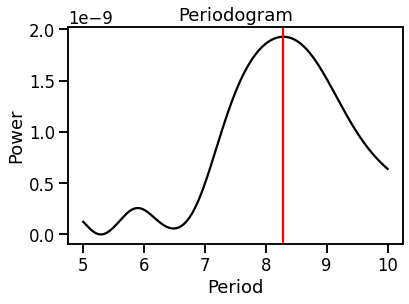

In [144]:
fig, ax = plt.subplots()
power = np.sum(best_fitting_weights[:2]**2, axis=0)
ax.plot(trial_periods, power, c='k')
ax.axvline(trial_periods[np.argmax(power)], color='r')
ax.set(xlabel='Period', ylabel='Power', title='Periodogram')

In [145]:
# Find the best period
period = trial_periods[np.argmax(power)]

# Remake the model at that period
A = np.vstack([np.sin(2 * np.pi * x/period), np.cos(2 * np.pi * x/period), np.ones_like(x)]).T
A = np.hstack([A, planets])

w = np.linalg.solve(A.T.dot(A), A.T.dot(y))

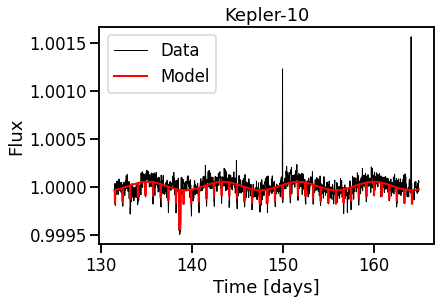

In [146]:
fig, ax = plt.subplots()
ax.plot(x, y, lw=1, label='Data', c='k')
ax.plot(x, A.dot(w), lw=2, label='Model', c='r')
ax.set(xlabel='Time [days]', ylabel='Flux', title='Kepler-10')
ax.legend();

Now our model includes both the rotation and the planet period!

## Higher order sinusoids

Sometimes our variability will not be sinusoidal, but will still be periodic. We can create a more flexible periodic model by including higher order terms of the periodogram. i.e.

\\[w_0 + w_1\sin(\frac{2x\pi}{P}) + w_2 \cos(\frac{2x\pi}{P}) + w_3\sin(2\frac{2x\pi}{P}) + w_4 \cos(2\frac{2x\pi}{P}) ...\\]

Let's try that in our model

In [147]:
planet_period = [0.837495 , 45.29485]
planet_t0 = [131.543749, 138.606099]
planet_duration = [2.1305/24, 6.9236/24]
planets = -np.asarray([((x - planet_t0[idx]) % planet_period[idx] < planet_duration[idx]/2) for idx in range(2)], float).T

trial_periods = 1/np.linspace(1/10, 1/5, 1000)[::-1]
best_fitting_weights = np.zeros((7, trial_periods.shape[0]))
for idx, trial_period in enumerate(trial_periods):
    # Design matrix that includes a sine and cosine with fixed period
    A = np.vstack([np.sin(2 * np.pi * x/trial_period), np.cos(2 * np.pi * x/trial_period), np.sin(4 * np.pi * x/trial_period), np.cos(4 * np.pi * x/trial_period), x**0]).T
    A = np.hstack([A, planets])
    # Fit to find best fitting weights
    best_fitting_weights[:, idx] = np.linalg.solve(A.T.dot(A), A.T.dot(y))

[Text(0.5, 0, 'Period'), Text(0, 0.5, 'Power'), Text(0.5, 1.0, 'Periodogram')]

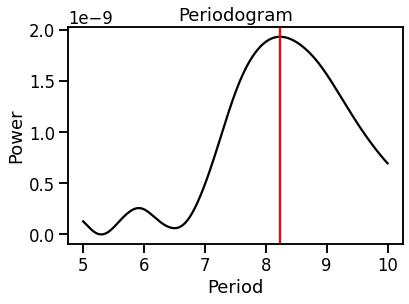

In [148]:
fig, ax = plt.subplots()
power = np.sum(best_fitting_weights[:2]**2, axis=0)
ax.plot(trial_periods, power, c='k')
ax.axvline(trial_periods[np.argmax(power)], color='r')
ax.set(xlabel='Period', ylabel='Power', title='Periodogram')

In [149]:
# Find the best period
period = trial_periods[np.argmax(power)]

# Remake the model at that period
A = np.vstack([np.sin(2 * np.pi * x/period), np.cos(2 * np.pi * x/period),np.sin(4 * np.pi * x/period), np.cos(4 * np.pi * x/period), np.ones_like(x)]).T
A = np.hstack([A, planets])

w = np.linalg.solve(A.T.dot(A), A.T.dot(y))

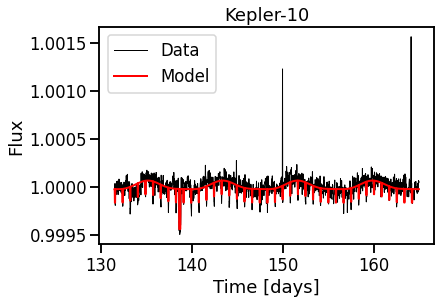

In [150]:
fig, ax = plt.subplots()
ax.plot(x, y, lw=1, label='Data', c='k')
ax.plot(x, A.dot(w), lw=2, label='Model', c='r')
ax.set(xlabel='Time [days]', ylabel='Flux', title='Kepler-10')
ax.legend();

This model fits better and is not quite sinusoidal, but is still periodic. 

# What are the takeaways?

Overall this has hopefully shown that

1. Linear regression is a powerful way to create fast, interpretable models for astronomical data

2. Linear regression models can incorporate measurement errors and priors to result in models that capture our uncertainty.

3. How you construct your model (what regressors, in what combinations) will impact your fit.

4. Linear models can be combined to account for astrophysics and systematics simultaneously. These components can then be broken apart to give the best fitting astrophysics **given the systematics**. 

## Now what?

These slides should give you an understanding of how to create linear regression models in a variety of situations. The next steps are to

1. Practice with some small examples to get a feel for building these types of model
2. Identify a problem in your work to apply this type of modeling to, and give it a go

## Questions?

Feel free to reach out to me either in person, or via email if you have any thoughts or questions!


<center><a href=mailto:christina.l.hedges@nasa.gov>christina.l.hedges@nasa.gov</a></center>